In [584]:
# Sources
# https://matheusfacure.github.io/python-causality-handbook/15-Synthetic-Control.html
# https://nbviewer.jupyter.org/github/OscarEngelbrektson/SyntheticControlMethods/blob/master/examples/user_guide.ipynb

In [585]:
import warnings
import imp
import ascm # get module reference for reload
import copy
import numpy as np
import os 
import pandas as pd
import seaborn as sns
import statsmodels.formula.api as smf
from ascm.graph import graph_original
from ascm.graph import ascm_dataframe
from ascm.graph import ascm_visualize
from ascm.graph import rmspe_table
from ascm.graph import p_value
from ascm.graph import placebo
from ascm.graph import ascm_limit_donor_pool
from matplotlib import style
from matplotlib import pyplot as plt
from matplotlib.colors import LogNorm
from operator import add
from scipy import stats
from scipy.optimize import fmin_slsqp
from scipy.stats import ttest_ind
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression,Ridge
from toolz import reduce, partial
from typing import List


imp.reload(ascm.graph)
warnings.filterwarnings('ignore')
%matplotlib inline
pd.set_option("display.max_columns", 6)
style.use("fivethirtyeight")

# read data file
# pandas read_csv
dirs = os.getcwd() 
files = os.listdir(dirs) 

data = pd.read_excel(r'/Users/jinhyun/Documents/GitHub/Python/UvA projects/Thesis/MSc/data/processed raw data_2.xlsx') 
data = data.loc[ (data.year < 2021) & (data.year >= 1965)]
raw_data = copy.deepcopy(data)# Copy dataframe



# 1. Data processing

In [586]:
data_gdp = data[
['year','country','GDP (current US$)',
 'Foreign direct investment, net inflows (BoP, current US$)','GDP growth (annual %)','Life expectancy at birth, total (years)'
 ,'Agriculture, forestry, and fishing, value added (% of GDP)'
 ,'Adolescent fertility rate (births per 1,000 women ages 15-19)'
 ,'Inflation, GDP deflator (annual %)'
 ,'School enrollment, primary (% gross)'
 ,'Fertility rate, total (births per woman)'
 , 'Surface area (sq. km)'
 ,'Mortality rate, under-5 (per 1,000 live births)']]

data_gdp_growth = data[
    ['year','country','GDP growth (annual %)','Industry (including construction), value added (% of GDP)',
    'Life expectancy at birth, total (years)','Inflation, GDP deflator (annual %)']]


data_inv = data[
    ['year','country','Gross capital formation (% of GDP)',
       'Industry (including construction), value added (% of GDP)',
       'Adolescent fertility rate (births per 1,000 women ages 15-19)',
       'Inflation, GDP deflator (annual %)',
       'Merchandise trade (% of GDP)',
       'Agriculture, forestry, and fishing, value added (% of GDP)',
       'School enrollment, primary (% gross)']]

data_export = data[
    ['year','country', 'Exports of goods and services (% of GDP)',
       'Industry (including construction), value added (% of GDP)',
       'Adolescent fertility rate (births per 1,000 women ages 15-19)',
       'Inflation, GDP deflator (annual %)',
       'Surface area (sq. km)',
       'Merchandise trade (% of GDP)',
       'Life expectancy at birth, total (years)',
       'School enrollment, primary (% gross)']]


data_import = data[
    ['year','country', 'Imports of goods and services (% of GDP)',
       'Industry (including construction), value added (% of GDP)',
       'Adolescent fertility rate (births per 1,000 women ages 15-19)',
       'Inflation, GDP deflator (annual %)',
       'Surface area (sq. km)',
       'Merchandise trade (% of GDP)',
       'Life expectancy at birth, total (years)',
       'School enrollment, primary (% gross)']]
       
data_fdi = data[
    ['year','country', 'Foreign direct investment, net inflows (BoP, current US$)',
       'Adolescent fertility rate (births per 1,000 women ages 15-19)',
       'Agriculture, forestry, and fishing, value added (% of GDP)',
       'Exports of goods and services (% of GDP)',
       'Fertility rate, total (births per woman)',
       'GDP (current US$)', 'GDP growth (annual %)',
       'Imports of goods and services (% of GDP)',
       'Industry (including construction), value added (% of GDP)',
       'Inflation, GDP deflator (annual %)',
       'Life expectancy at birth, total (years)',
       'Merchandise trade (% of GDP)',
       'Mortality rate, under-5 (per 1,000 live births)',
       'Population density (people per sq. km of land area)',
        'Population, total',
       'School enrollment, primary (% gross)', 'Surface area (sq. km)',
       'Urban population growth (annual %)' ]]


In [587]:
display(data_gdp)

,year,country,GDP (current US$),...,"Fertility rate, total (births per woman)",Surface area (sq. km),"Mortality rate, under-5 (per 1,000 live births)"
5,1965,Algeria,3.136259e+09,...,7.675000,2381740.000,244.500000
6,1966,Algeria,3.039835e+09,...,7.676000,2381740.000,245.200000
7,1967,Algeria,3.370843e+09,...,7.672000,2381740.000,245.200000
8,1968,Algeria,3.852116e+09,...,7.666000,2381740.000,244.200000
9,1969,Algeria,4.257219e+09,...,7.656000,2381740.000,242.000000
...,...,...,...,...,...,...,...
4570,2016,European Union,1.389326e+13,...,1.566241,4172271.600,4.165583
4571,2017,European Union,1.476599e+13,...,1.556049,4172076.830,4.110764
4572,2018,European Union,1.597821e+13,...,1.542059,4172838.889,4.031467
4573,2019,European Union,1.568936e+13,...,1.525078,18270.000,3.943376


In [588]:
display(data_gdp_growth)

,year,country,GDP growth (annual %),"Industry (including construction), value added (% of GDP)","Life expectancy at birth, total (years)","Inflation, GDP deflator (annual %)"
5,1965,Algeria,6.206898,35.860933,48.394000,1.501331
6,1966,Algeria,-4.804971,35.860933,48.811000,1.817815
7,1967,Algeria,9.452963,35.860933,49.210000,1.312041
8,1968,Algeria,10.796239,35.860933,49.597000,3.142056
9,1969,Algeria,8.433280,35.860933,49.982000,1.921085
...,...,...,...,...,...,...
4570,2016,European Union,2.008266,22.793653,80.949865,0.874115
4571,2017,European Union,2.813595,22.723281,80.930839,1.464064
4572,2018,European Union,2.065499,22.704654,81.027024,2.002209
4573,2019,European Union,1.816850,22.646120,81.313270,2.199604


In [589]:
display(data_inv)

,year,country,Gross capital formation (% of GDP),...,Merchandise trade (% of GDP),"Agriculture, forestry, and fishing, value added (% of GDP)","School enrollment, primary (% gross)"
5,1965,Algeria,22.603944,...,41.705741,11.106980,74.465683
6,1966,Algeria,17.324132,...,41.581210,11.106980,74.465683
7,1967,Algeria,23.434417,...,40.405322,11.106980,74.465683
8,1968,Algeria,27.867922,...,42.703804,11.106980,74.465683
9,1969,Algeria,32.352736,...,45.640126,11.106980,74.465683
...,...,...,...,...,...,...,...
4570,2016,European Union,20.947080,...,69.037866,1.587936,101.602577
4571,2017,European Union,21.569979,...,71.975157,1.693777,101.832970
4572,2018,European Union,22.146677,...,73.506501,1.609880,101.509720
4573,2019,European Union,22.934326,...,72.454613,1.591050,101.294121


In [590]:
display(data_export)

,year,country,Exports of goods and services (% of GDP),...,Merchandise trade (% of GDP),"Life expectancy at birth, total (years)","School enrollment, primary (% gross)"
5,1965,Algeria,22.603944,...,41.705741,48.394000,74.465683
6,1966,Algeria,25.986198,...,41.581210,48.811000,74.465683
7,1967,Algeria,23.434417,...,40.405322,49.210000,74.465683
8,1968,Algeria,23.135635,...,42.703804,49.597000,74.465683
9,1969,Algeria,23.788777,...,45.640126,49.982000,74.465683
...,...,...,...,...,...,...,...
4570,2016,European Union,46.684512,...,69.037866,80.949865,101.602577
4571,2017,European Union,48.354594,...,71.975157,80.930839,101.832970
4572,2018,European Union,49.198138,...,73.506501,81.027024,101.509720
4573,2019,European Union,49.344668,...,72.454613,81.313270,101.294121


In [591]:
display(data_import)

,year,country,Imports of goods and services (% of GDP),...,Merchandise trade (% of GDP),"Life expectancy at birth, total (years)","School enrollment, primary (% gross)"
5,1965,Algeria,25.833078,...,41.705741,48.394000,74.465683
6,1966,Algeria,24.653572,...,41.581210,48.811000,74.465683
7,1967,Algeria,21.631769,...,40.405322,49.210000,74.465683
8,1968,Algeria,24.187254,...,42.703804,49.597000,74.465683
9,1969,Algeria,28.070758,...,45.640126,49.982000,74.465683
...,...,...,...,...,...,...,...
4570,2016,European Union,42.306978,...,69.037866,80.949865,101.602577
4571,2017,European Union,44.077874,...,71.975157,80.930839,101.832970
4572,2018,European Union,45.325864,...,73.506501,81.027024,101.509720
4573,2019,European Union,45.897118,...,72.454613,81.313270,101.294121


In [592]:
display(data_fdi)

,year,country,"Foreign direct investment, net inflows (BoP, current US$)",...,"School enrollment, primary (% gross)",Surface area (sq. km),Urban population growth (annual %)
5,1965,Algeria,8.012000e+07,...,74.465683,2381740.000,6.729878
6,1966,Algeria,8.012000e+07,...,74.465683,2381740.000,5.894366
7,1967,Algeria,8.012000e+07,...,74.465683,2381740.000,3.266680
8,1968,Algeria,8.012000e+07,...,74.465683,2381740.000,3.307126
9,1969,Algeria,8.012000e+07,...,74.465683,2381740.000,3.292629
...,...,...,...,...,...,...,...
4570,2016,European Union,7.297543e+11,...,101.602577,4172271.600,0.479309
4571,2017,European Union,5.400017e+11,...,101.832970,4172076.830,0.430422
4572,2018,European Union,-3.415352e+10,...,101.509720,4172838.889,0.445310
4573,2019,European Union,1.783994e+11,...,101.294121,18270.000,0.359546


# Result

## 1. Raw data

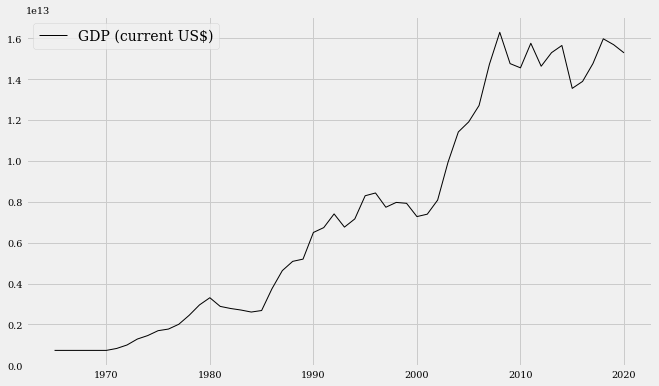

In [593]:
graph_original('European Union','GDP (current US$)', data_gdp)

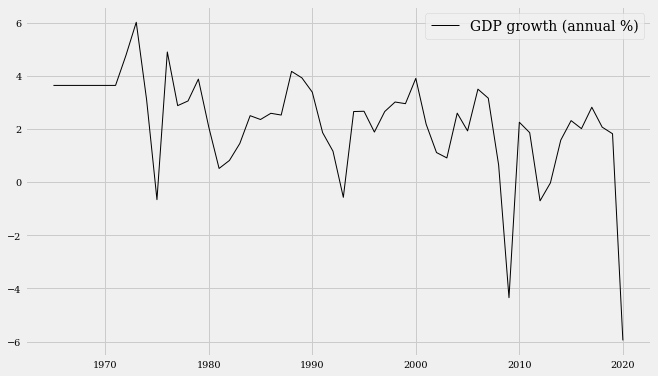

In [595]:
graph_original('European Union','GDP growth (annual %)',data_gdp_growth)

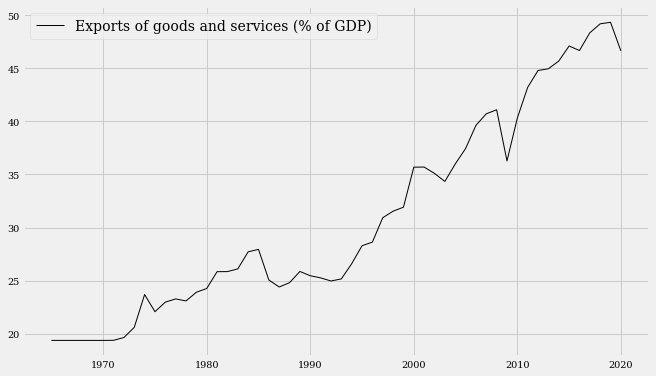

In [596]:
graph_original('European Union','Exports of goods and services (% of GDP)', data_export)

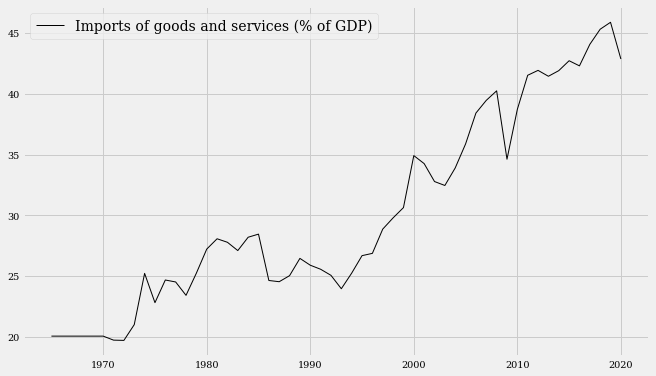

In [597]:
graph_original('European Union','Imports of goods and services (% of GDP)', data_import)

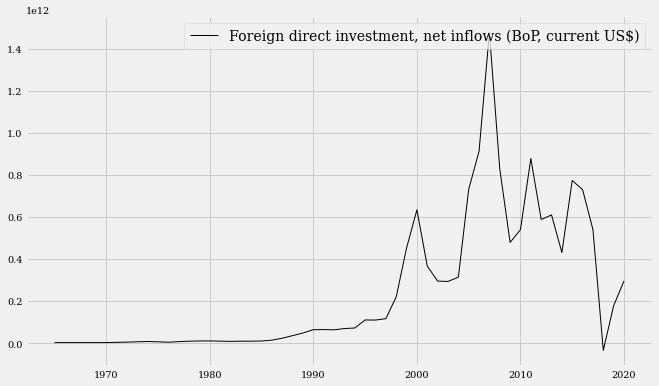

In [598]:
graph_original('European Union','Foreign direct investment, net inflows (BoP, current US$)', data_fdi)

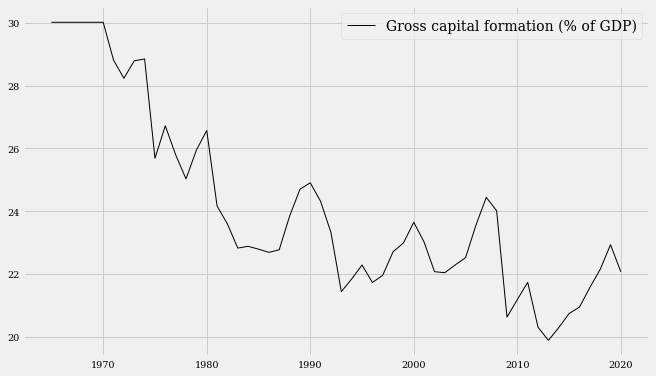

In [599]:
graph_original('European Union','Gross capital formation (% of GDP)', data_inv)

## 1.2 Dataframe of Difference

In [600]:
ascm_dataframe('European Union','GDP (current US$)', data_gdp, incident= 'QE', incident_year=2009)

Pre- RMSPE : 0.672182387459166
Post- RMSPE : 1.7296717596378866


,country,year,GDP (current US$),ASCM,Difference
4519,European Union,1965,7.259311e+11,1.976478e+11,5.282834e+11
4520,European Union,1966,7.259311e+11,2.304571e+11,4.954740e+11
4521,European Union,1967,7.259311e+11,2.078856e+11,5.180455e+11
4522,European Union,1968,7.259311e+11,1.954812e+11,5.304499e+11
4523,European Union,1969,7.259311e+11,2.175651e+11,5.083660e+11
4524,European Union,1970,7.259311e+11,2.537035e+11,4.722276e+11
4525,European Union,1971,8.208130e+11,2.772500e+11,5.435630e+11
4526,European Union,1972,9.904287e+11,3.311914e+11,6.592373e+11
4527,European Union,1973,1.282021e+12,4.246519e+11,8.573687e+11
4528,European Union,1974,1.451750e+12,3.850346e+11,1.066715e+12


In [601]:
ascm_dataframe('European Union','GDP growth (annual %)', data_gdp_growth, incident= 'QE', incident_year=2009)

Pre- RMSPE : 1.9642319552773726
Post- RMSPE : 23.30646654554046


,country,year,GDP growth (annual %),ASCM,Difference
4519,European Union,1965,3.634559,3.439565,0.194994
4520,European Union,1966,3.634559,4.178231,-0.543672
4521,European Union,1967,3.634559,6.184115,-2.549556
4522,European Union,1968,3.634559,5.644118,-2.009559
4523,European Union,1969,3.634559,5.619359,-1.984800
4524,European Union,1970,3.634559,5.160246,-1.525687
4525,European Union,1971,3.634559,4.949930,-1.315371
4526,European Union,1972,4.759649,8.125599,-3.365950
4527,European Union,1973,6.009138,4.642669,1.366469
4528,European Union,1974,3.095644,2.780397,0.315247


In [602]:
ascm_dataframe('European Union','Exports of goods and services (% of GDP)', data_export, incident= 'QE', incident_year=2009)

Pre- RMSPE : 0.1418782476654889
Post- RMSPE : 0.21279190540557036


,country,year,Exports of goods and services (% of GDP),ASCM,Difference
4519,European Union,1965,19.364094,16.948190,2.415903
4520,European Union,1966,19.364094,17.454319,1.909775
4521,European Union,1967,19.364094,16.333475,3.030618
4522,European Union,1968,19.364094,16.975612,2.388481
4523,European Union,1969,19.364094,16.426232,2.937862
4524,European Union,1970,19.364094,17.237396,2.126697
4525,European Union,1971,19.370930,15.306019,4.064911
4526,European Union,1972,19.635161,16.086094,3.549067
4527,European Union,1973,20.591952,18.127542,2.464410
4528,European Union,1974,23.685329,16.964089,6.721240


In [603]:
ascm_dataframe('European Union','Imports of goods and services (% of GDP)', data_import, incident= 'QE', incident_year=2009)

Pre- RMSPE : 0.09023993688066338
Post- RMSPE : 0.13278616557844877


,country,year,Imports of goods and services (% of GDP),ASCM,Difference
4519,European Union,1965,20.039114,21.017813,-0.978698
4520,European Union,1966,20.039114,19.823885,0.215229
4521,European Union,1967,20.039114,19.141817,0.897297
4522,European Union,1968,20.039114,19.402812,0.636303
4523,European Union,1969,20.039114,18.673138,1.365976
4524,European Union,1970,20.039114,20.081758,-0.042644
4525,European Union,1971,19.709263,18.997910,0.711352
4526,European Union,1972,19.687489,17.355766,2.331723
4527,European Union,1973,20.986673,17.923323,3.063350
4528,European Union,1974,25.208597,23.533594,1.675003


In [604]:
ascm_dataframe('European Union','Gross capital formation (% of GDP)', data_inv, incident= 'QE', incident_year=2009)

Pre- RMSPE : 0.10039886536924084
Post- RMSPE : 0.10750962227906978


,country,year,Gross capital formation (% of GDP),ASCM,Difference
4519,European Union,1965,30.016778,24.164495,5.852283
4520,European Union,1966,30.016778,24.679121,5.337657
4521,European Union,1967,30.016778,25.912190,4.104588
4522,European Union,1968,30.016778,25.036915,4.979863
4523,European Union,1969,30.016778,26.203840,3.812938
4524,European Union,1970,30.016778,25.231608,4.785170
4525,European Union,1971,28.812516,26.624576,2.187940
4526,European Union,1972,28.234240,24.573879,3.660361
4527,European Union,1973,28.790352,26.515435,2.274917
4528,European Union,1974,28.848407,28.401136,0.447271


In [605]:
ascm_dataframe('European Union', 'Foreign direct investment, net inflows (BoP, current US$)', data_fdi, incident= 'QE', incident_year=2009)

Pre- RMSPE : 0.7663515731978118
Post- RMSPE : 2.385431102871565


,country,year,"Foreign direct investment, net inflows (BoP, current US$)",ASCM,Difference
4519,European Union,1965,2.899569e+09,1.684756e+08,2.731094e+09
4520,European Union,1966,2.899569e+09,1.684756e+08,2.731094e+09
4521,European Union,1967,2.899569e+09,1.684756e+08,2.731094e+09
4522,European Union,1968,2.899569e+09,1.684756e+08,2.731094e+09
4523,European Union,1969,2.899569e+09,1.684756e+08,2.731094e+09
4524,European Union,1970,2.899569e+09,1.684756e+08,2.731094e+09
4525,European Union,1971,4.101957e+09,-1.040175e+08,4.205975e+09
4526,European Union,1972,5.247234e+09,5.565637e+08,4.690670e+09
4527,European Union,1973,6.849956e+09,1.045566e+09,5.804390e+09
4528,European Union,1974,8.012974e+09,6.313010e+08,7.381673e+09


## 1.3 Augmented Synthetic Control Method

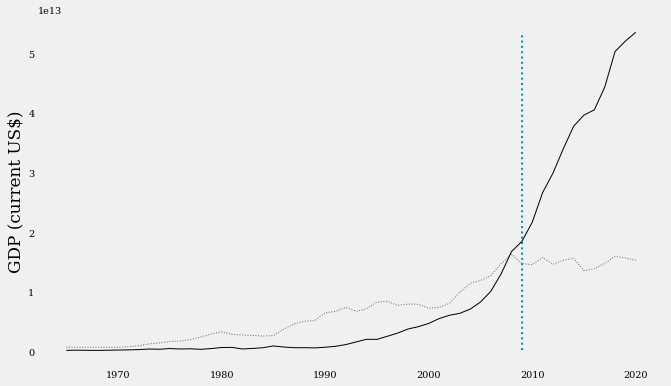

In [606]:
ascm_visualize('European Union','GDP (current US$)', data_gdp, incident= 'QE', incident_year=2009, std_scaling=True, ylabel=False)

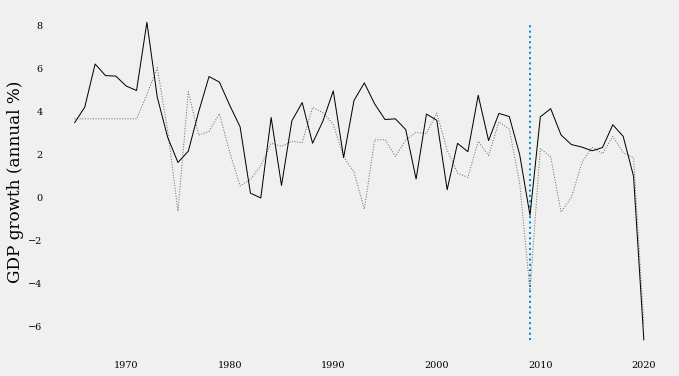

In [607]:
ascm_visualize('European Union','GDP growth (annual %)', data_gdp_growth, incident= 'QE', incident_year=2009, std_scaling=True, ylabel=False)

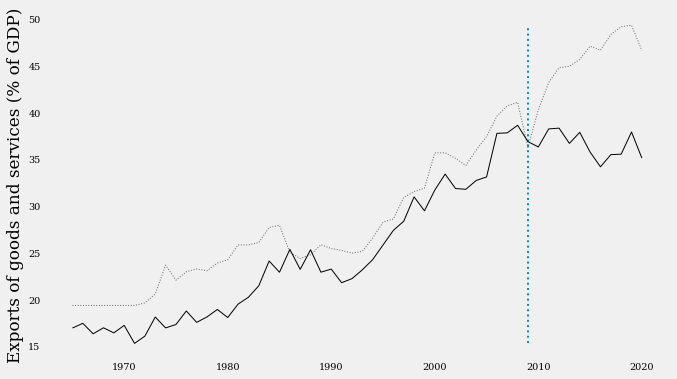

In [608]:
ascm_visualize('European Union','Exports of goods and services (% of GDP)', data_export, incident= 'QE', incident_year=2009, std_scaling=True, ylabel=False)

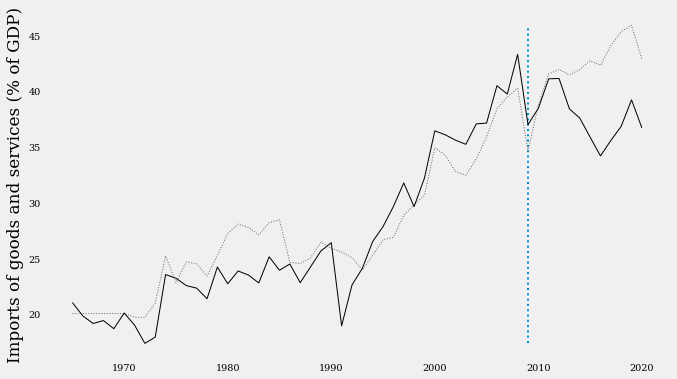

In [609]:
ascm_visualize('European Union','Imports of goods and services (% of GDP)', data_import, incident= 'QE', incident_year=2009, std_scaling=True, ylabel=False)

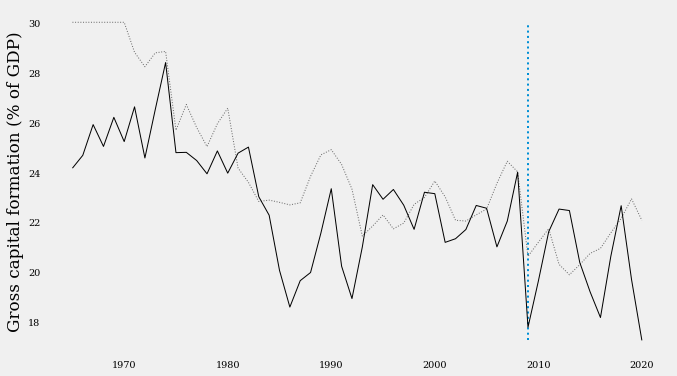

In [610]:
ascm_visualize('European Union','Gross capital formation (% of GDP)', data_inv, incident= 'QE', incident_year=2009, std_scaling=True, ylabel=False)

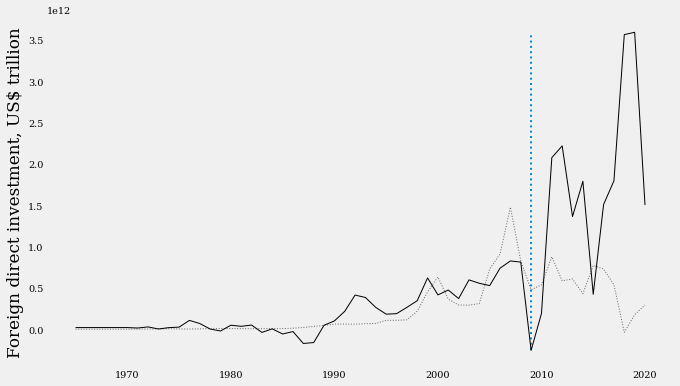

In [594]:
ascm_visualize('European Union','Foreign direct investment, net inflows (BoP, current US$)', data_fdi, incident= 'QE', incident_year=2009, std_scaling=False, ylabel="Foreign direct investment, US$ trillion")

## 1.4 RMSPE ratio

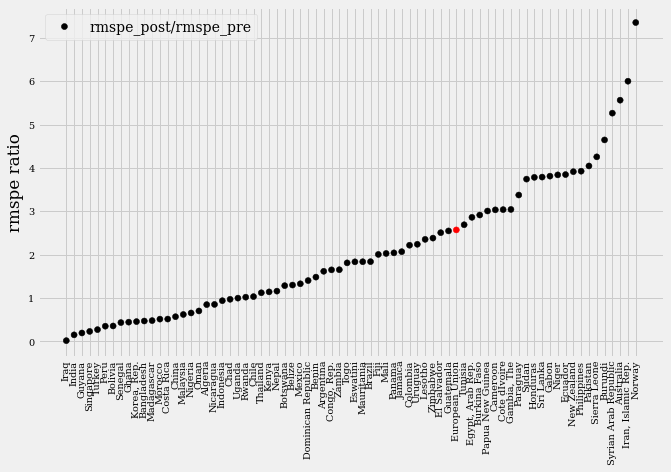

In [612]:
rmspe_table('European Union', 'GDP (current US$)', data_gdp,  incident= 'QE' ,incident_year=2009, outlier = 1)

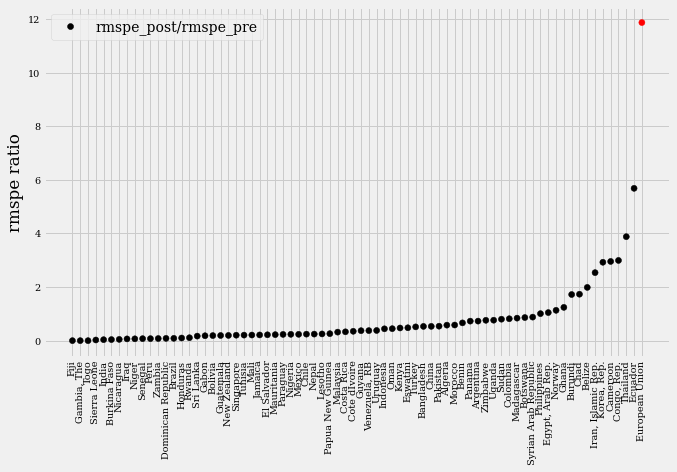

In [613]:
rmspe_table('European Union', 'GDP growth (annual %)', data_gdp_growth,  incident= 'QE' ,incident_year=2009, outlier = 1)

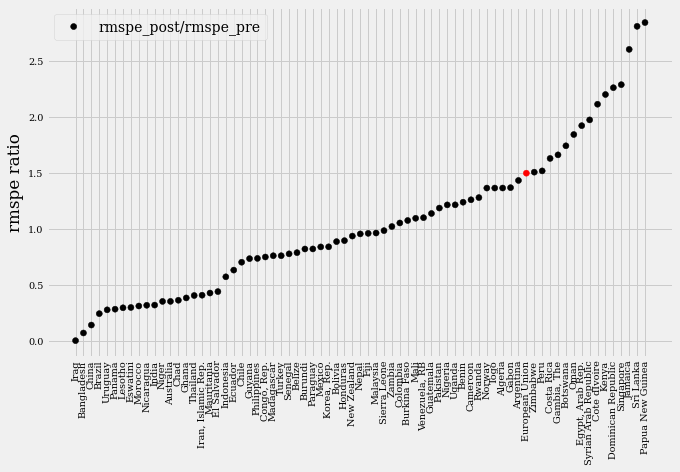

In [614]:
rmspe_table('European Union', 'Exports of goods and services (% of GDP)', data_export,  incident= 'QE' ,incident_year=2009, outlier = 2)

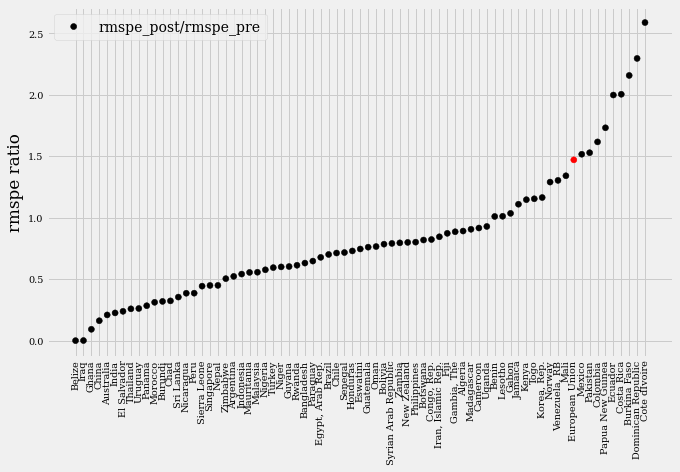

In [615]:
rmspe_table('European Union', 'Imports of goods and services (% of GDP)', data_import,  incident= 'QE' ,incident_year=2009, outlier = 2)

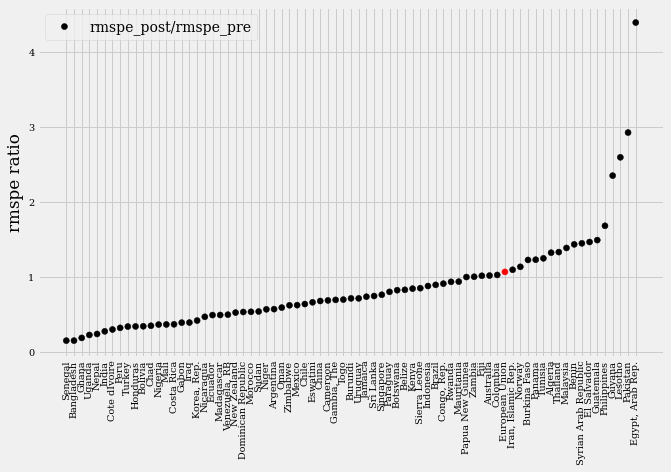

In [616]:
rmspe_table('European Union', 'Gross capital formation (% of GDP)', data_inv,  incident= 'QE' ,incident_year=2009, outlier = 0)

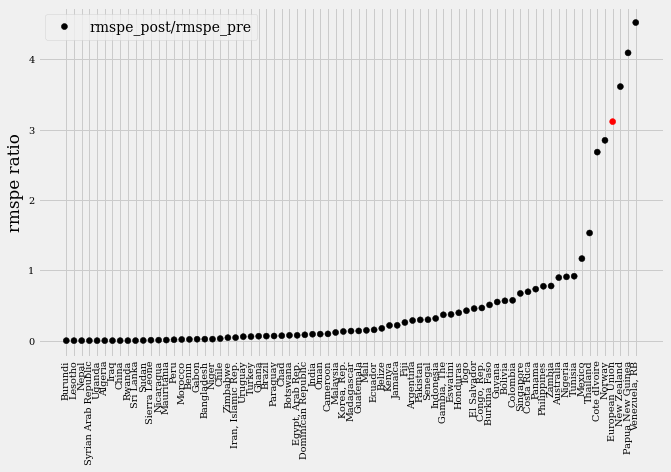

In [617]:
rmspe_table('European Union','Foreign direct investment, net inflows (BoP, current US$)', data_fdi,  incident= 'QE' ,incident_year=2009, outlier = 0)

## 1.5 placebo effect analysis

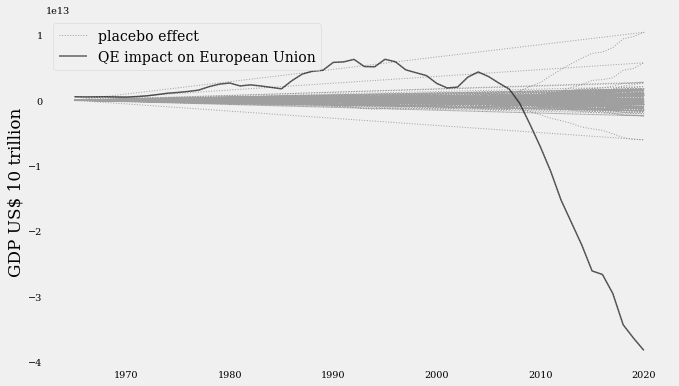

In [618]:
placebo('European Union','GDP (current US$)', data_gdp, incident_year = 2009, ylabel="GDP US$ 10 trillion" )

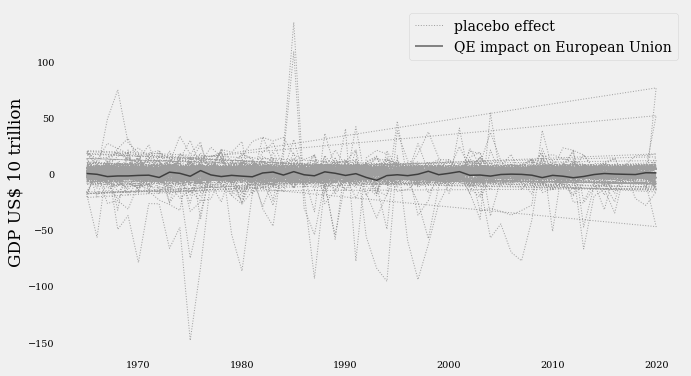

In [619]:
placebo('European Union','GDP growth (annual %)', data_gdp_growth, incident_year = 2009, ylabel="GDP US$ 10 trillion" )

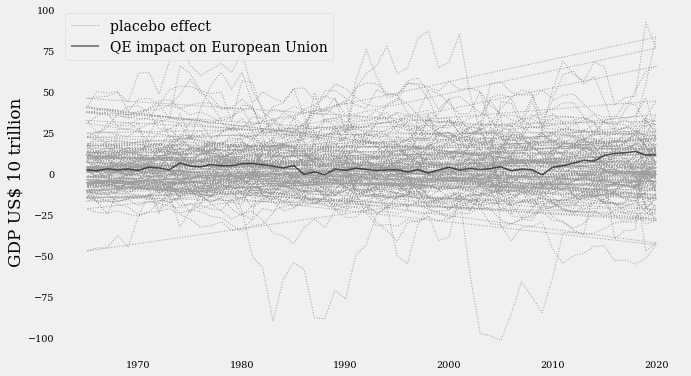

In [620]:
placebo('European Union','Exports of goods and services (% of GDP)', data_export, incident_year = 2009, ylabel="GDP US$ 10 trillion" )

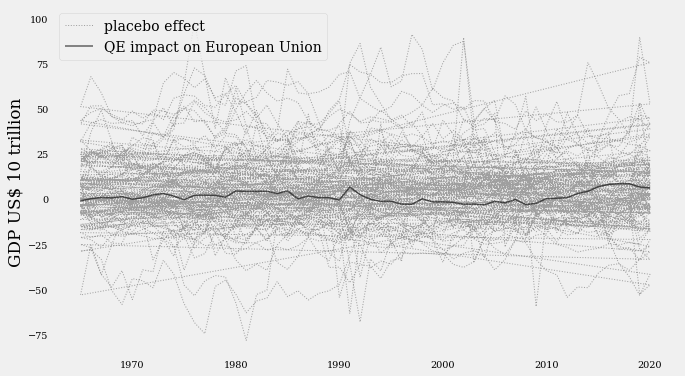

In [621]:
placebo('European Union', 'Imports of goods and services (% of GDP)', data_import, incident_year = 2009, ylabel="GDP US$ 10 trillion" )

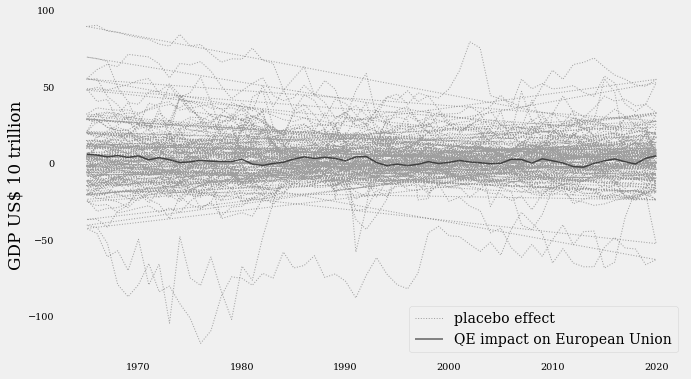

In [622]:
placebo('European Union','Gross capital formation (% of GDP)', data_inv, incident_year = 2009, ylabel="GDP US$ 10 trillion" )

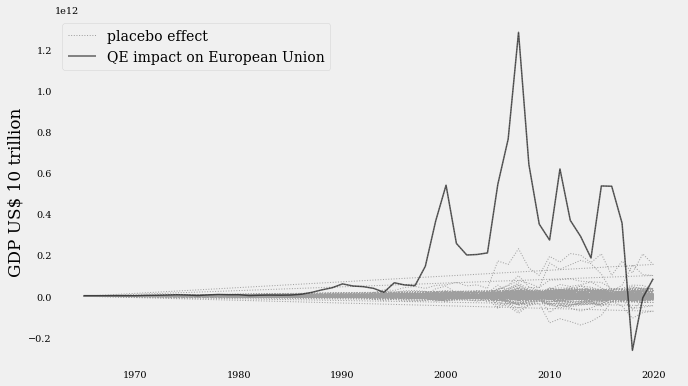

In [623]:
placebo('European Union','Foreign direct investment, net inflows (BoP, current US$)', data_fdi, incident_year = 2009, ylabel="GDP US$ 10 trillion" )

## 1.6 p-value analysis

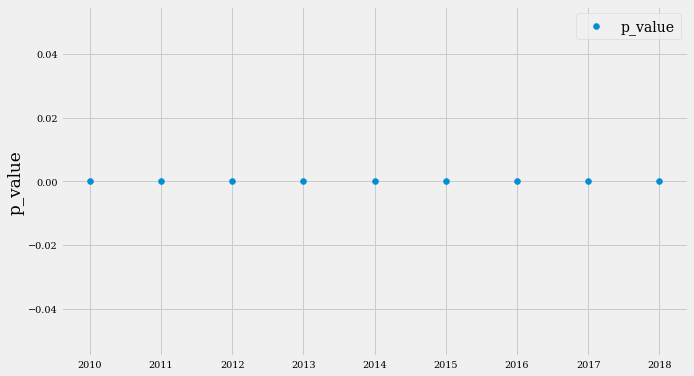

In [624]:
p_value('European Union','GDP (current US$)', data_gdp, incident_year = 2009, detail= False)

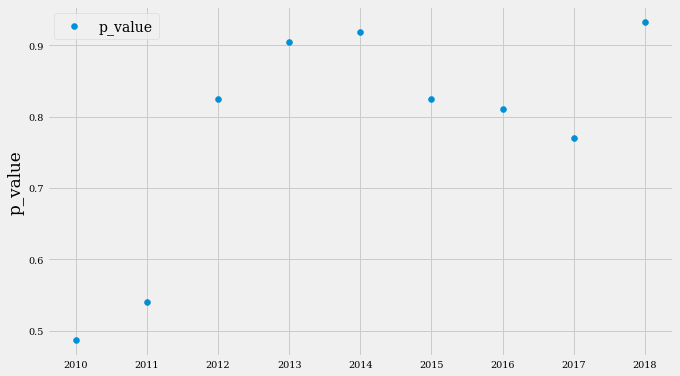

In [625]:
p_value('European Union','GDP growth (annual %)', data_gdp_growth, incident_year = 2009, detail= False)

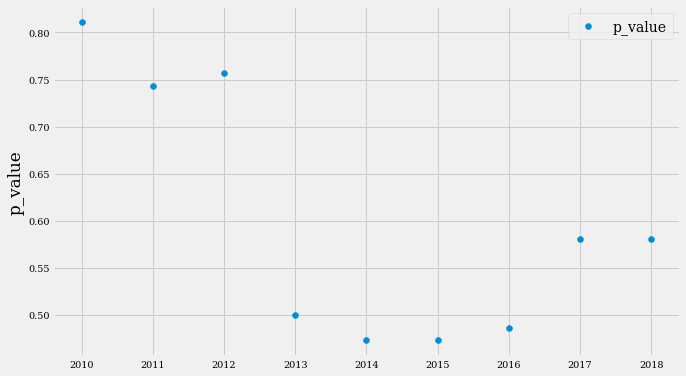

In [626]:
p_value('European Union','Exports of goods and services (% of GDP)', data_export, incident_year = 2009, detail= False)

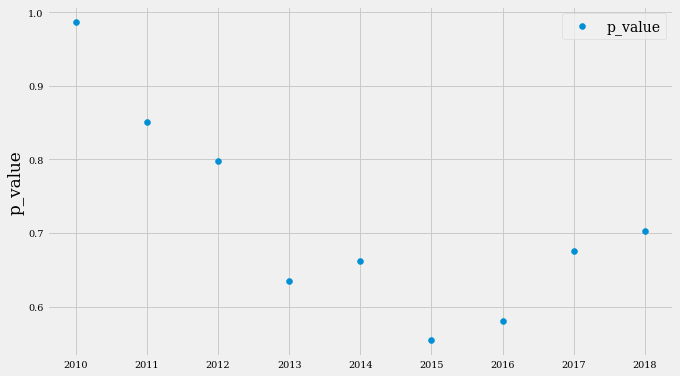

In [627]:
p_value('European Union','Imports of goods and services (% of GDP)', data_import, incident_year = 2009, detail= False)

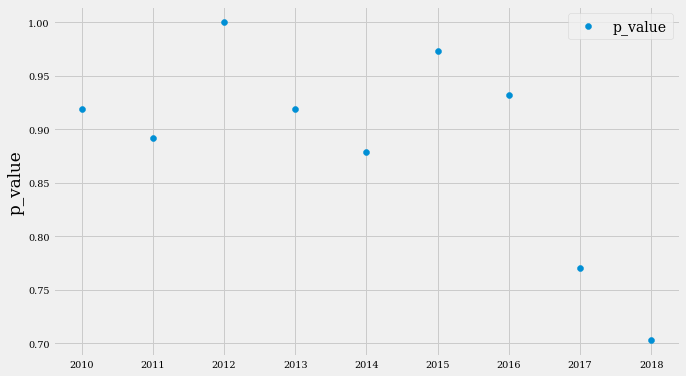

In [628]:
p_value('European Union', 'Gross capital formation (% of GDP)', data_inv,  incident_year = 2009, detail= False)

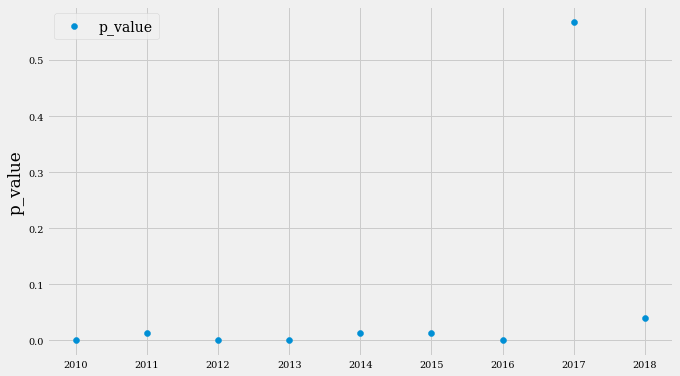

In [629]:
p_value('European Union','Foreign direct investment, net inflows (BoP, current US$)', data_fdi,  incident_year = 2009, detail= False)

## 1.7 Limitation  of donor pool test

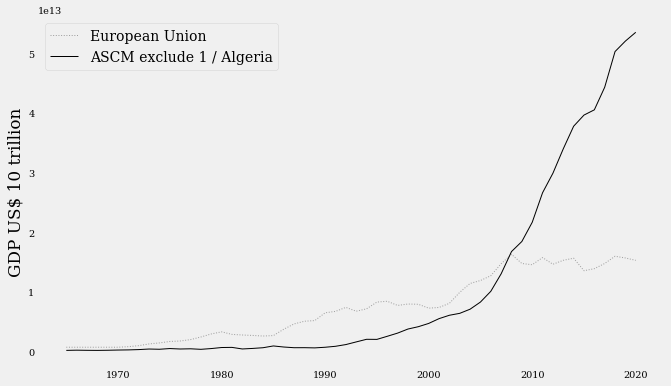

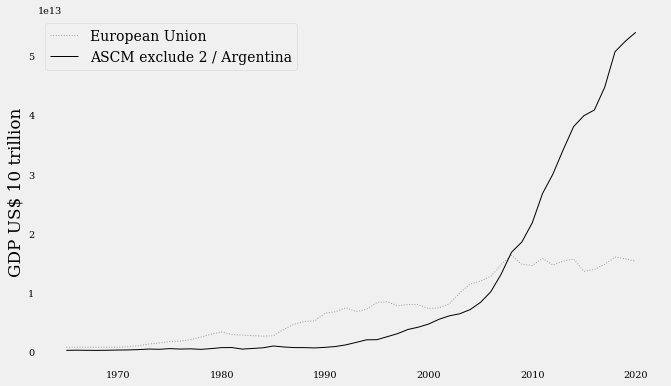

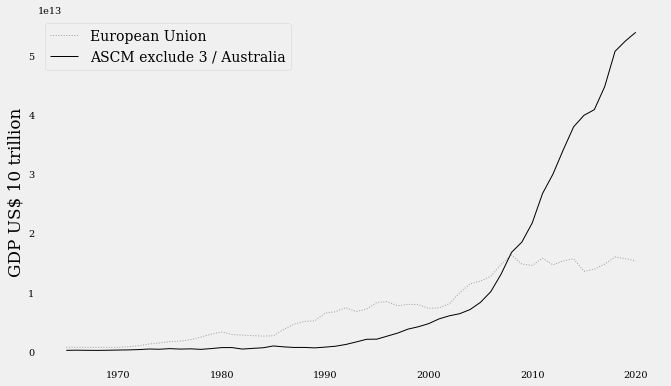

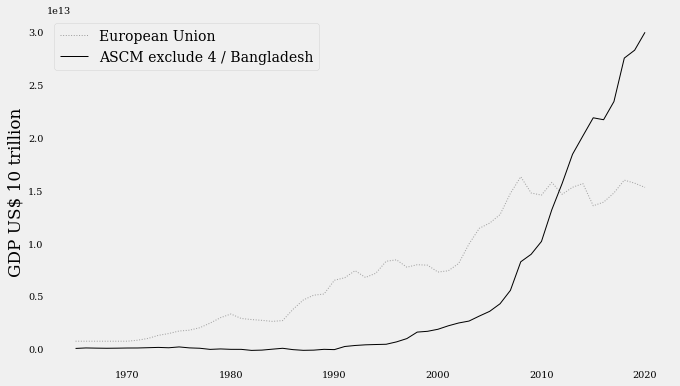

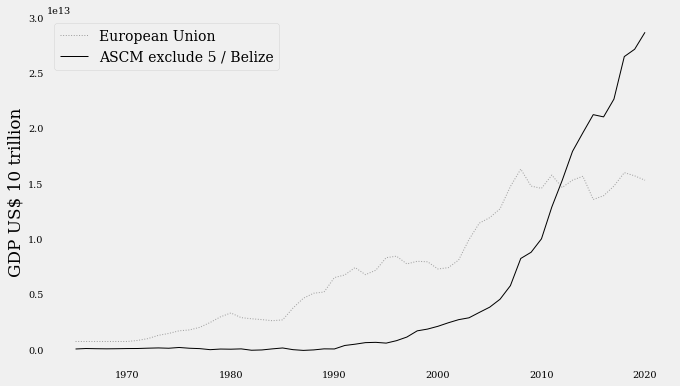

...

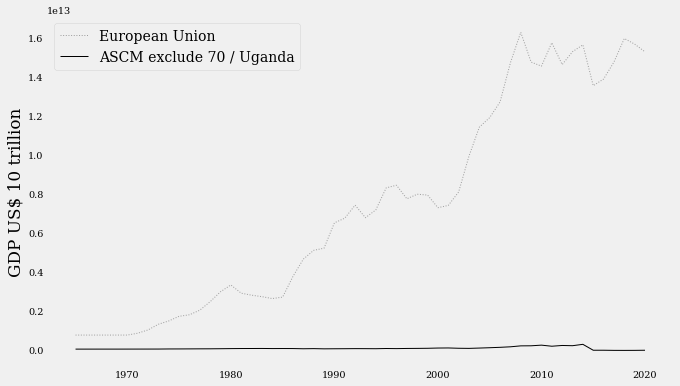

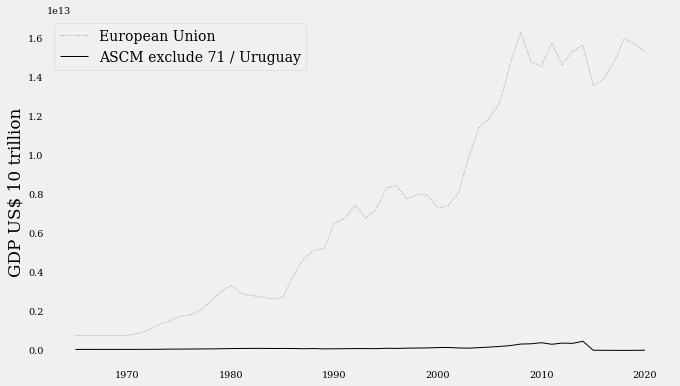

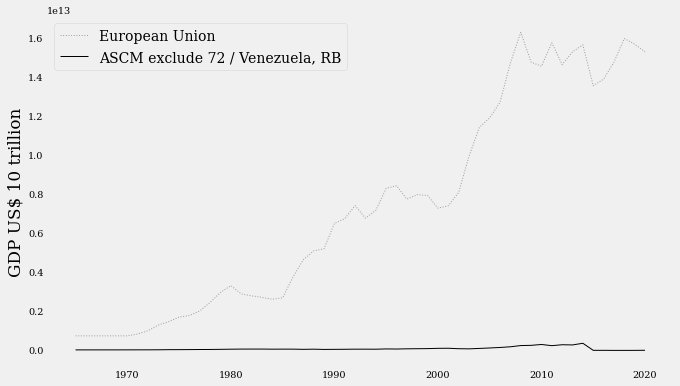

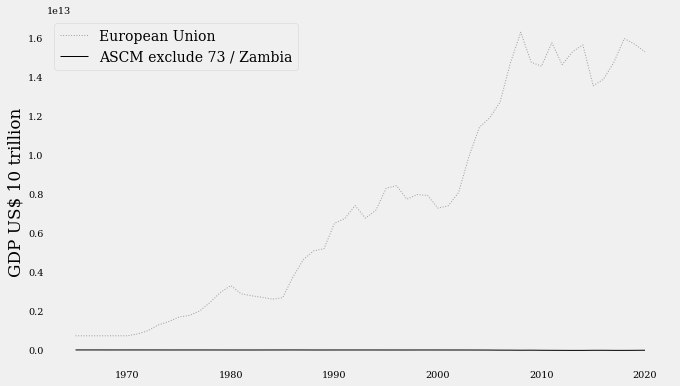

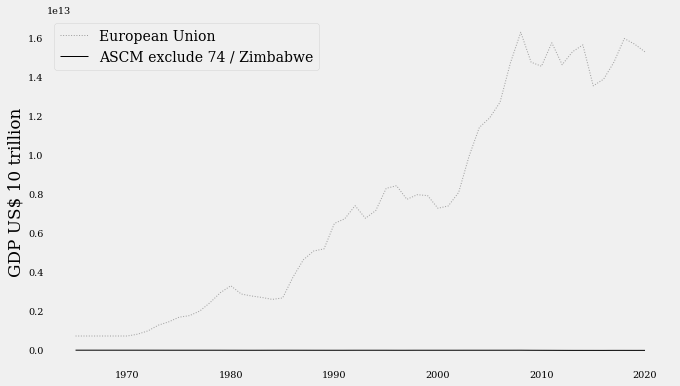

In [630]:
ascm_limit_donor_pool('European Union','GDP (current US$)', data_gdp, incident_year = 2009, std_scaling=True, detail = False, ylabel="GDP US$ 10 trillion")

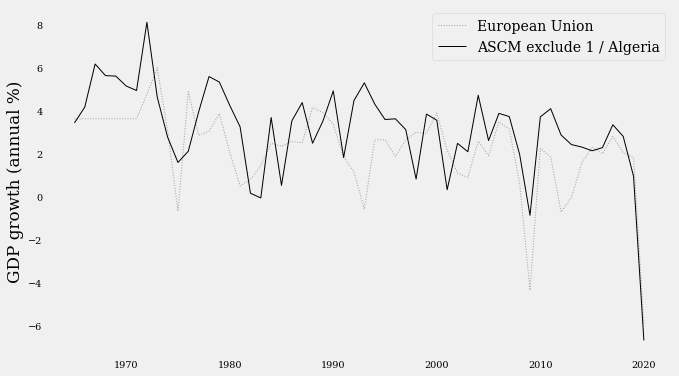

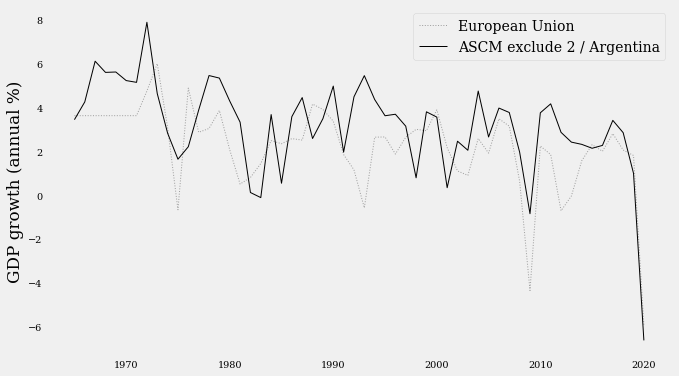

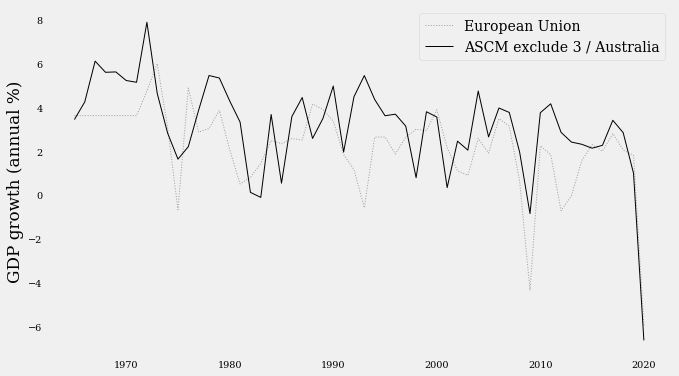

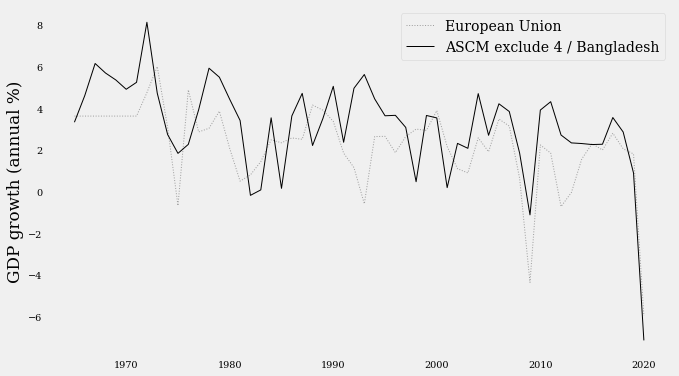

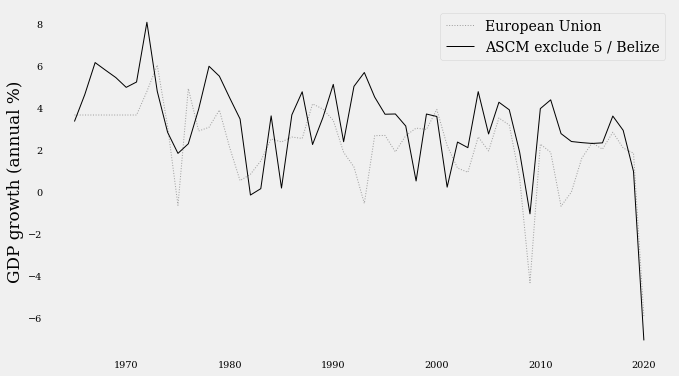

...

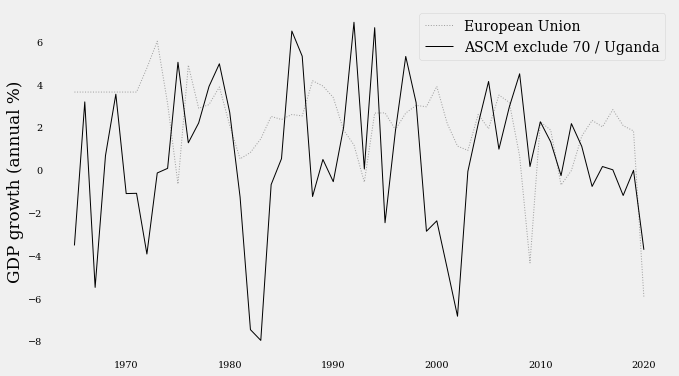

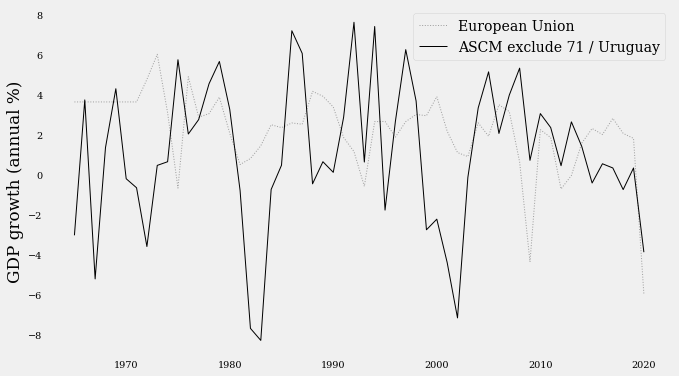

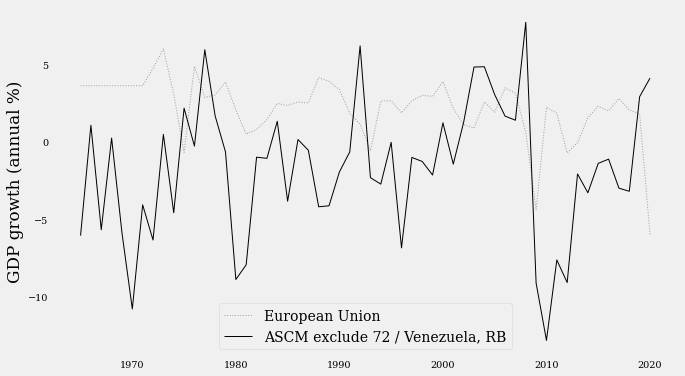

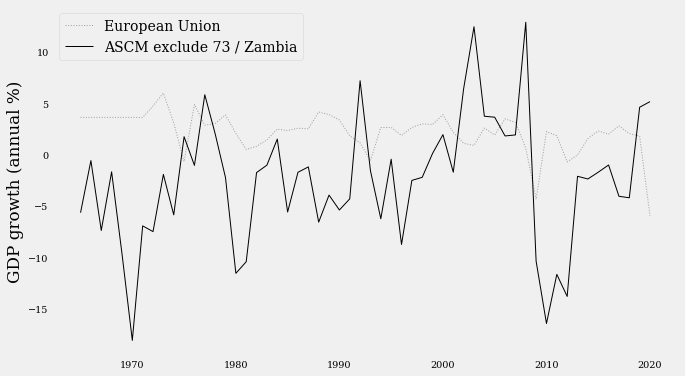

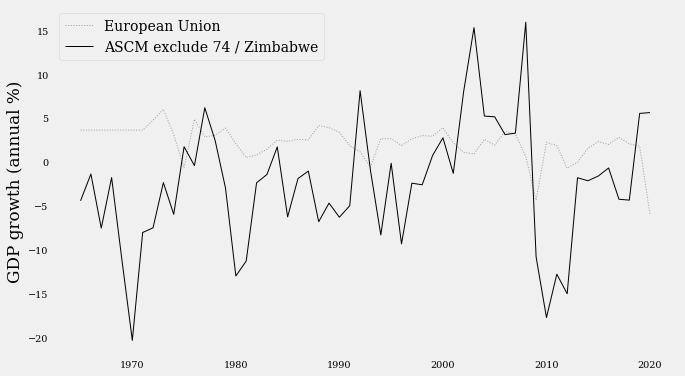

In [631]:
ascm_limit_donor_pool('European Union','GDP growth (annual %)', data_gdp_growth, incident_year = 2009, std_scaling=True, detail = False, ylabel=False)

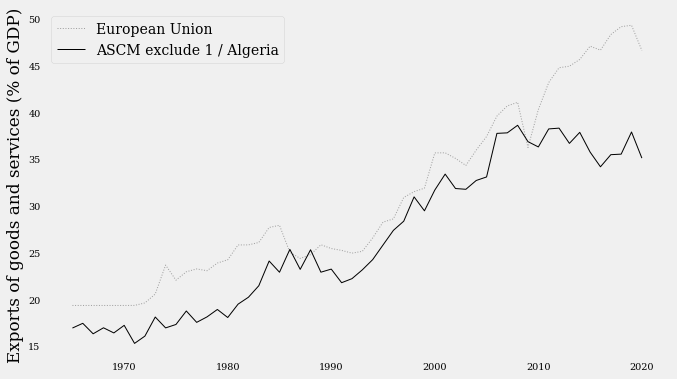

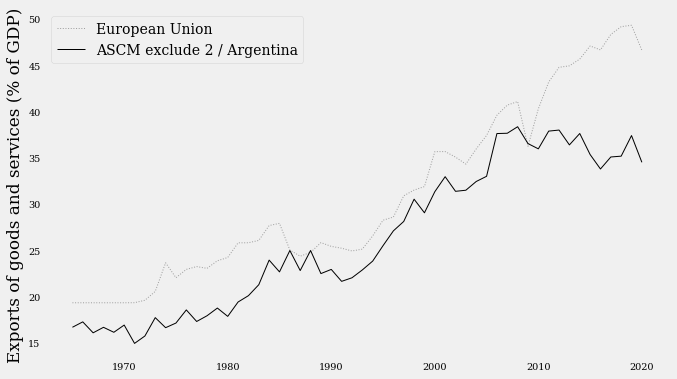

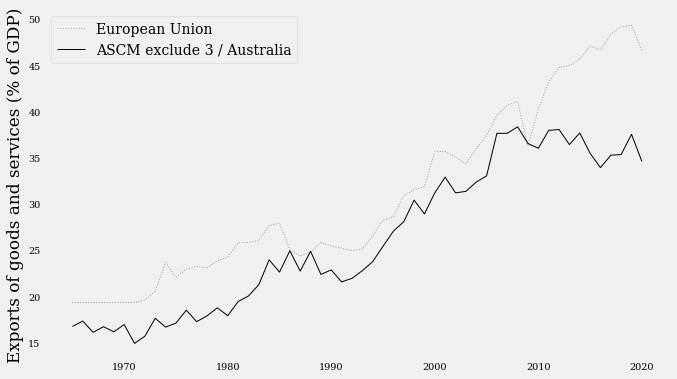

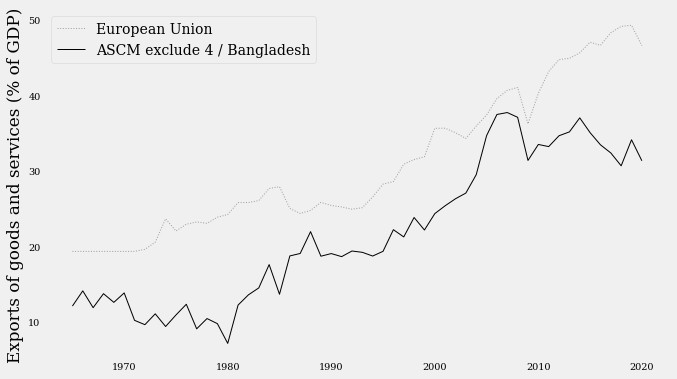

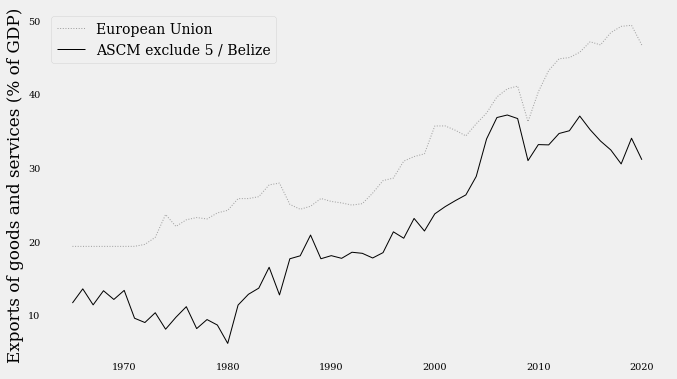

...

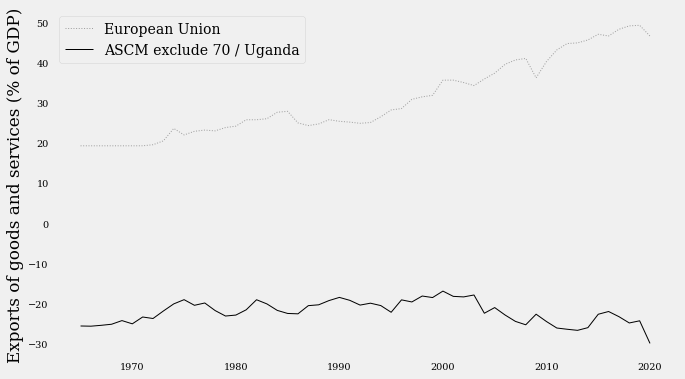

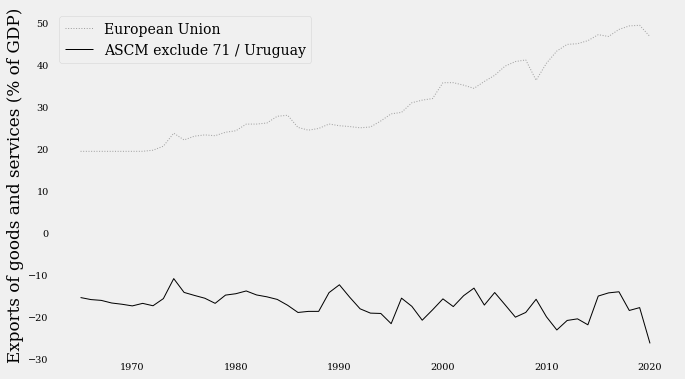

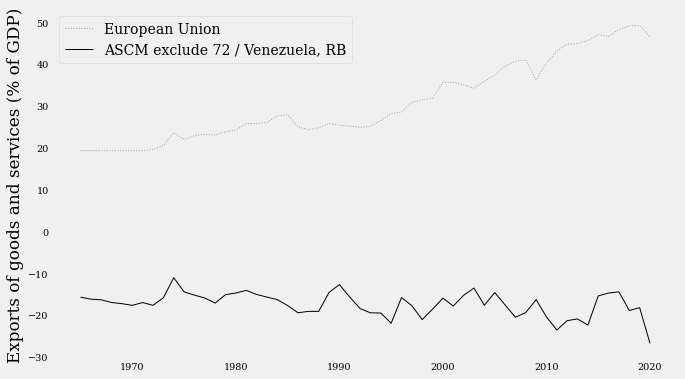

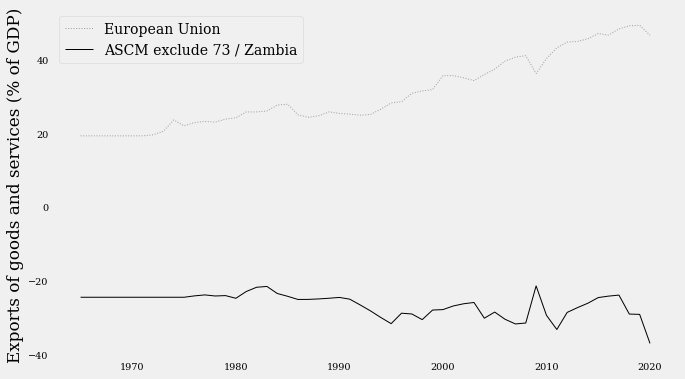

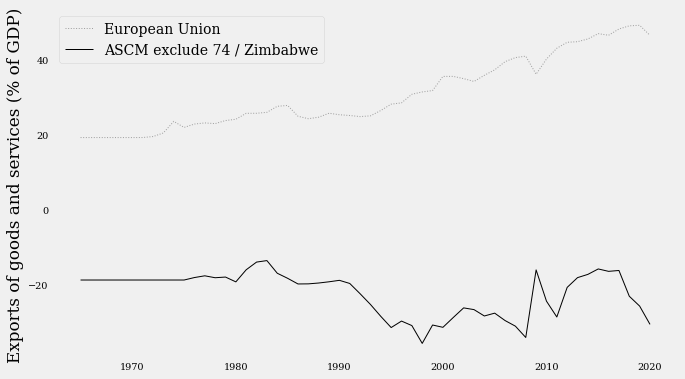

In [632]:
ascm_limit_donor_pool('European Union', 'Exports of goods and services (% of GDP)', data_export,  incident_year = 2009, std_scaling=True, detail = False, ylabel=False)

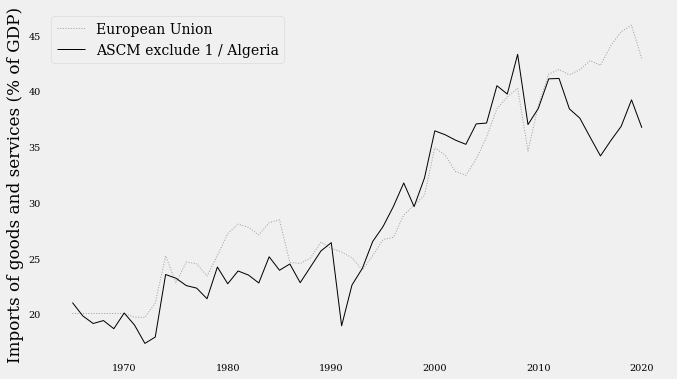

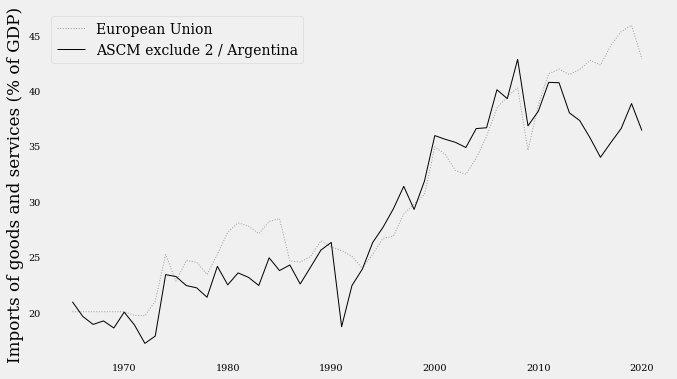

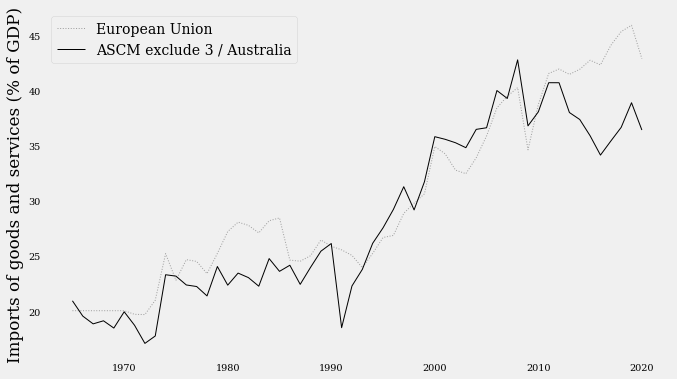

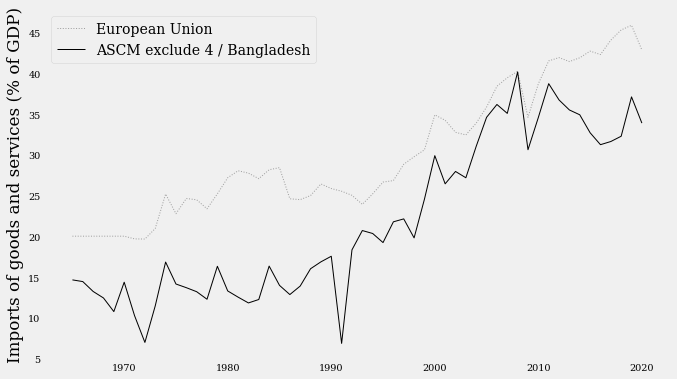

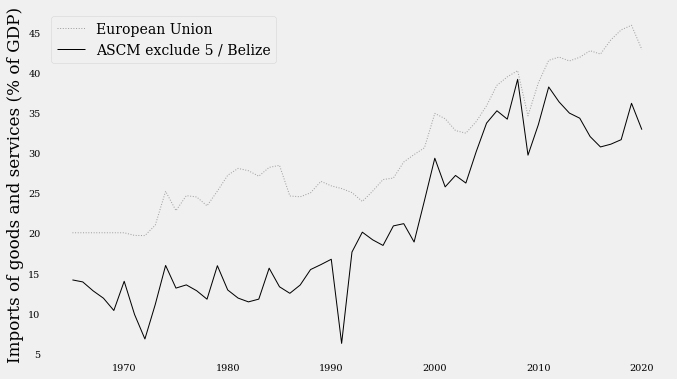

...

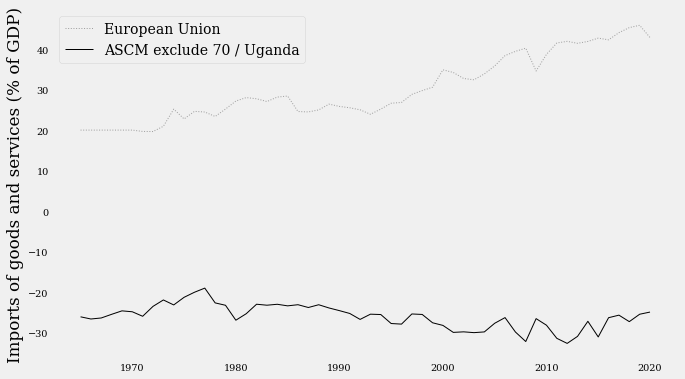

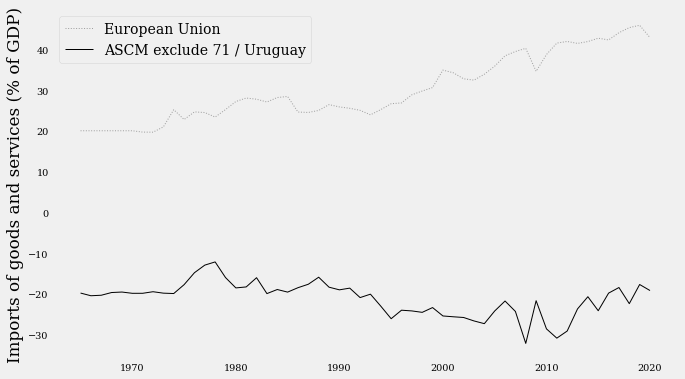

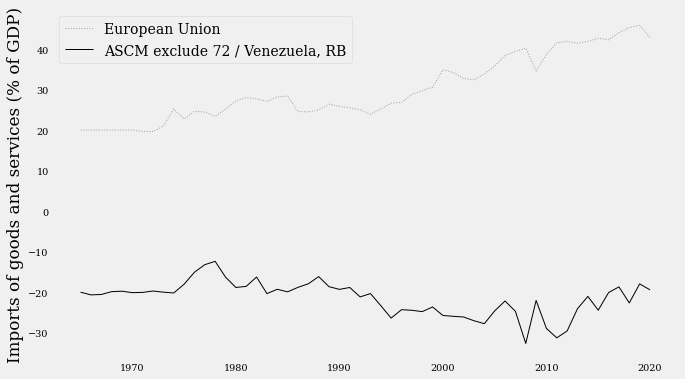

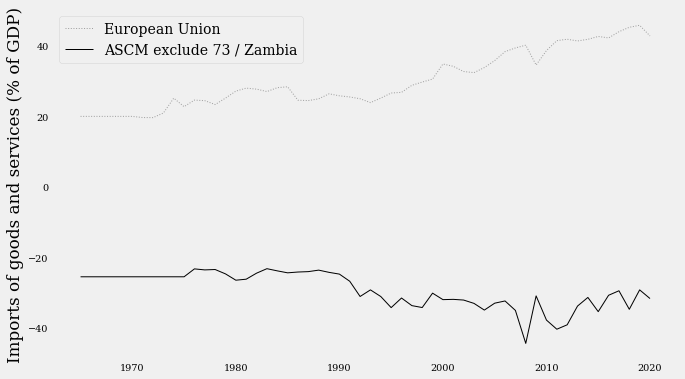

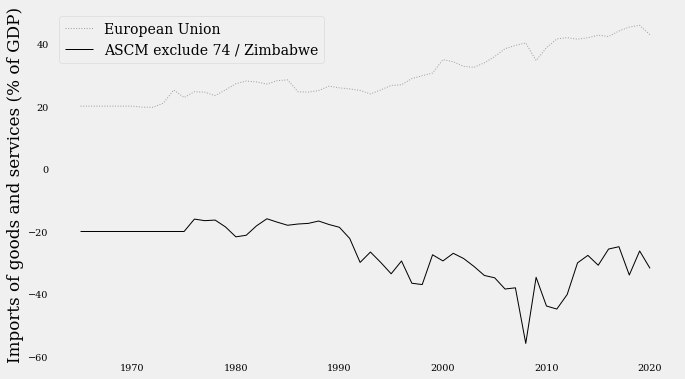

In [633]:
ascm_limit_donor_pool('European Union','Imports of goods and services (% of GDP)', data_import,  incident_year = 2009, std_scaling=True, detail = False, ylabel=False)

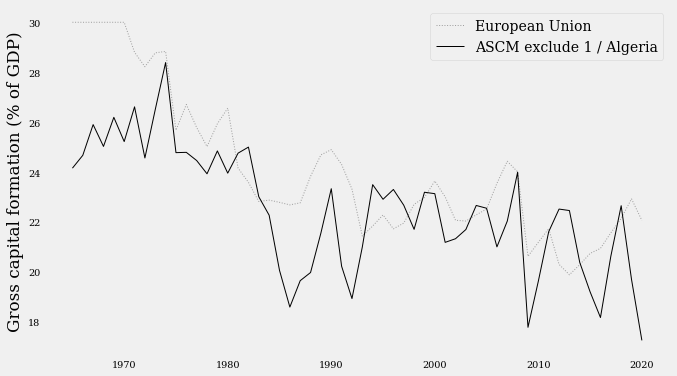

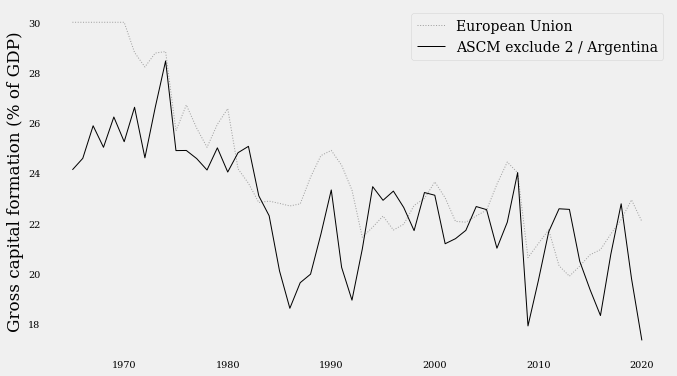

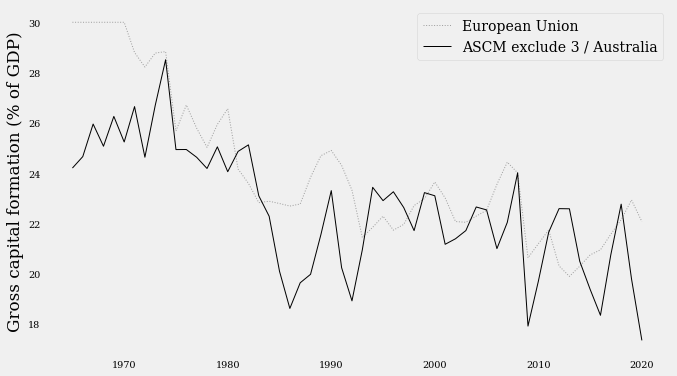

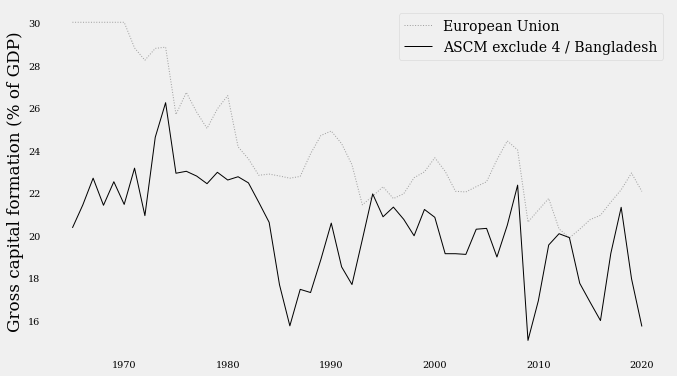

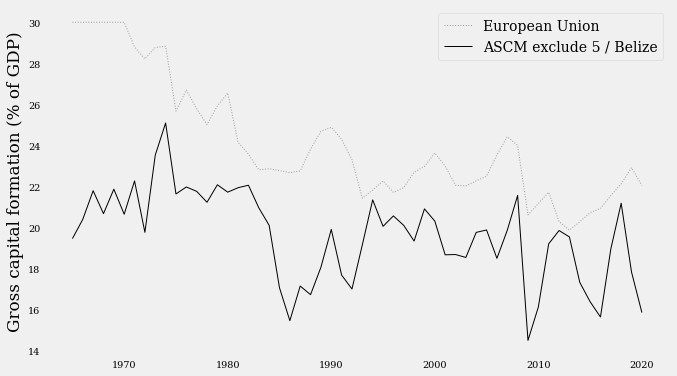

...

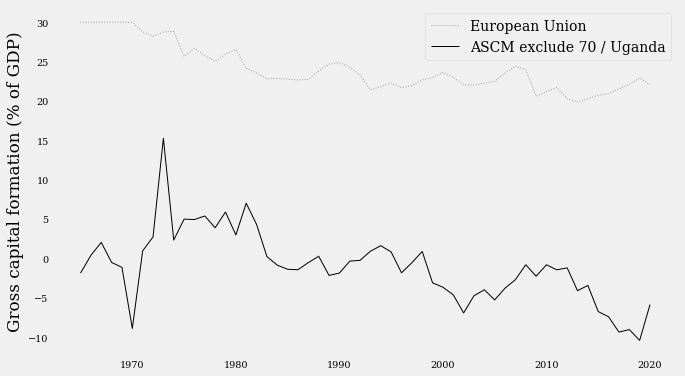

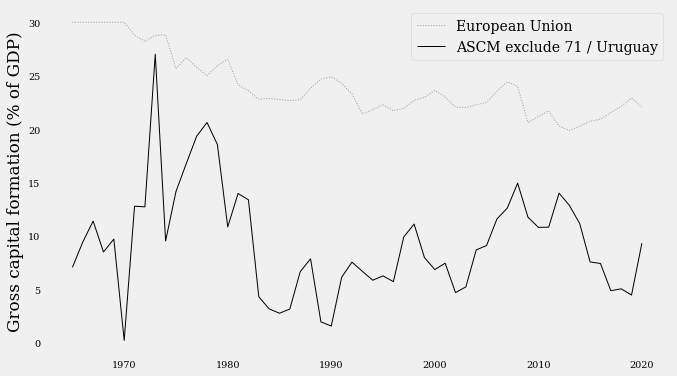

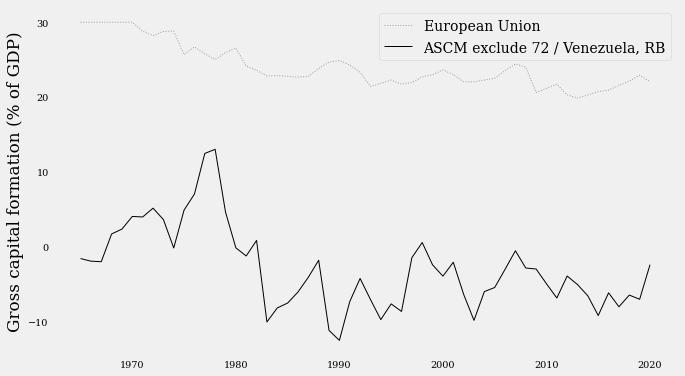

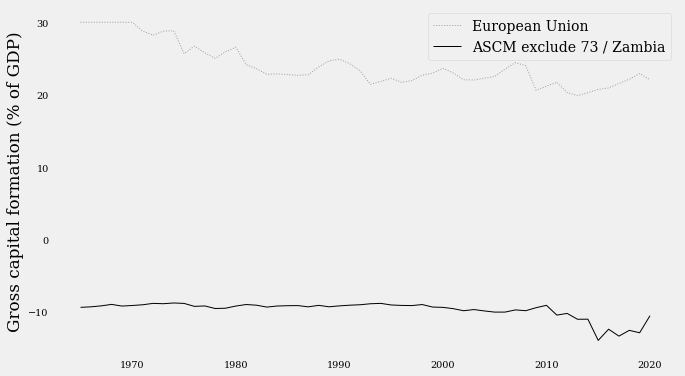

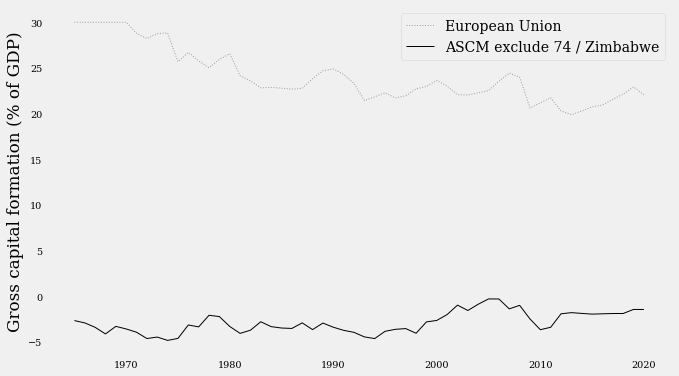

In [634]:
ascm_limit_donor_pool('European Union', 'Gross capital formation (% of GDP)', data_inv, incident_year = 2009, std_scaling=True, detail = False, ylabel=False)

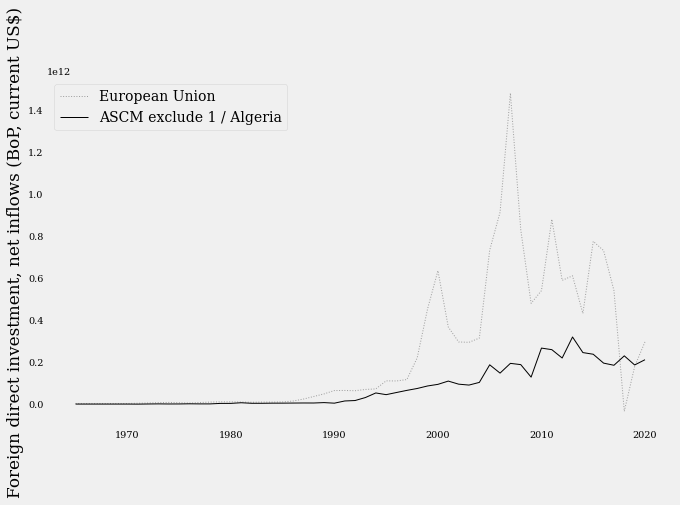

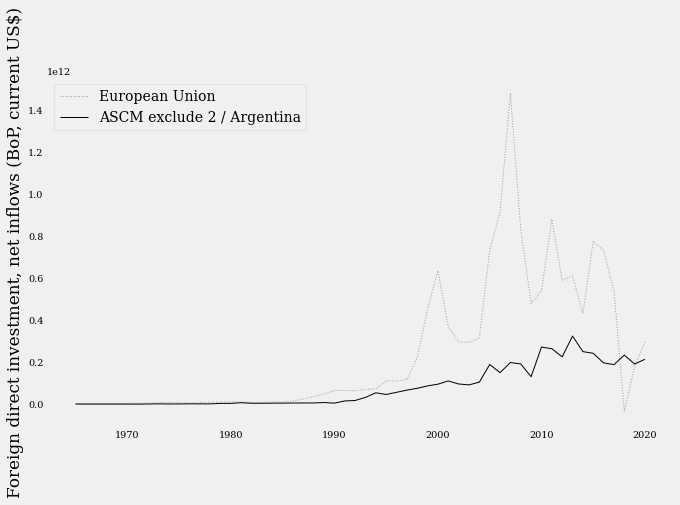

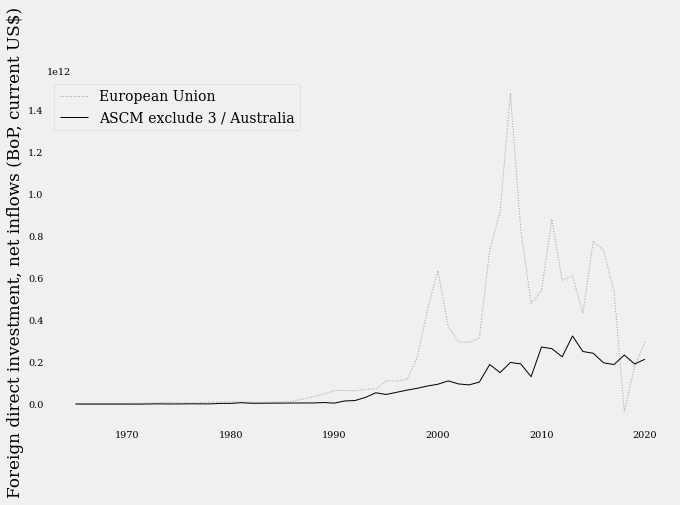

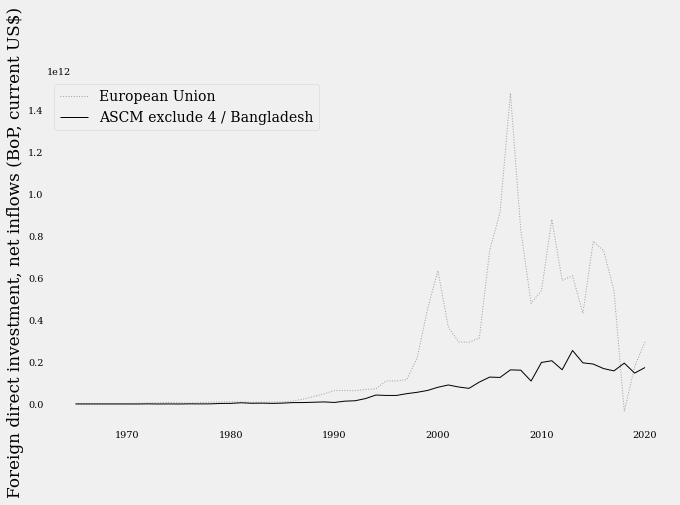

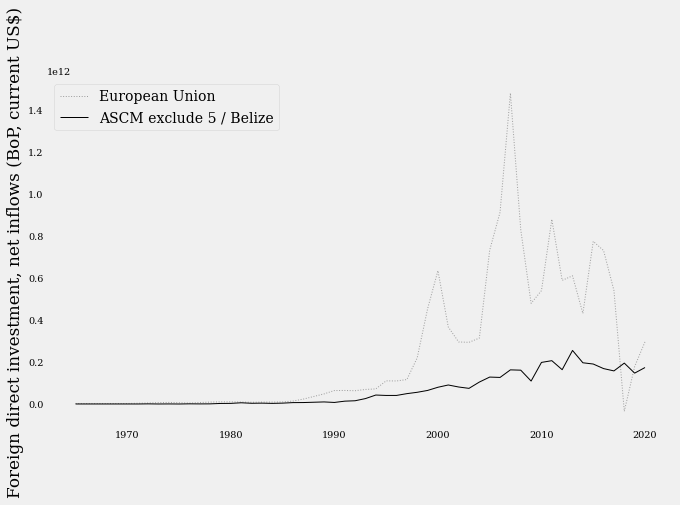

...

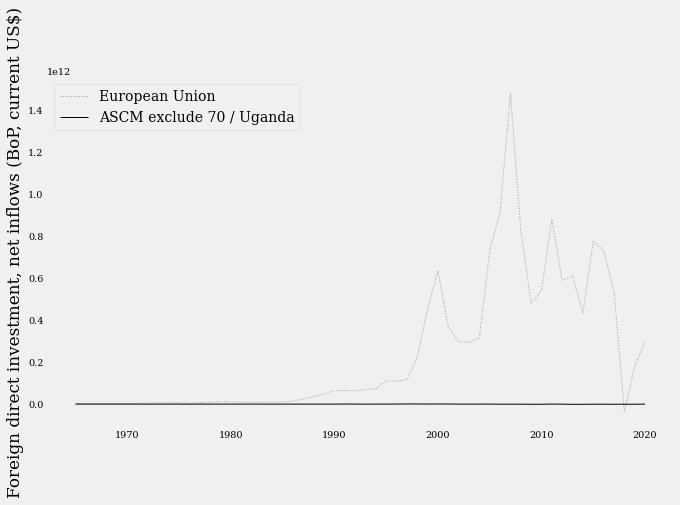

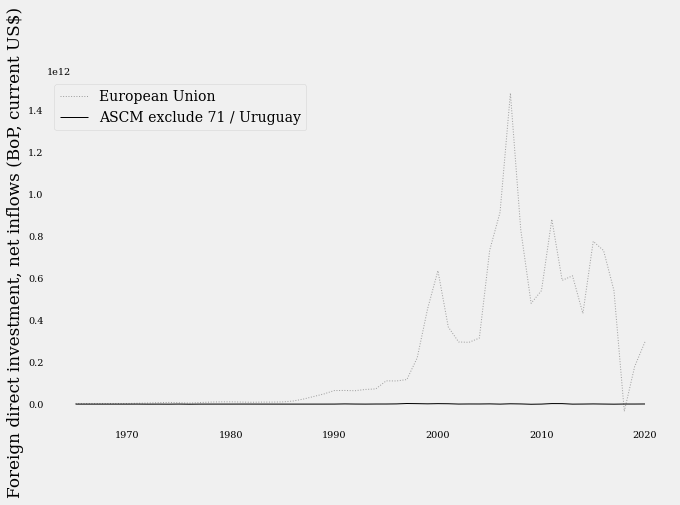

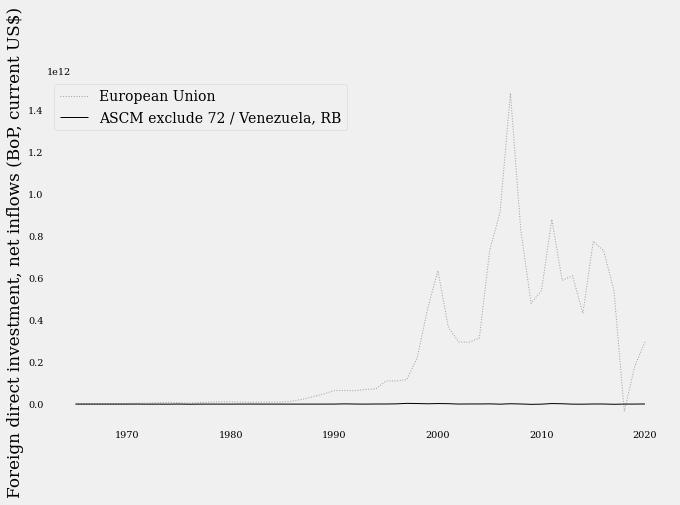

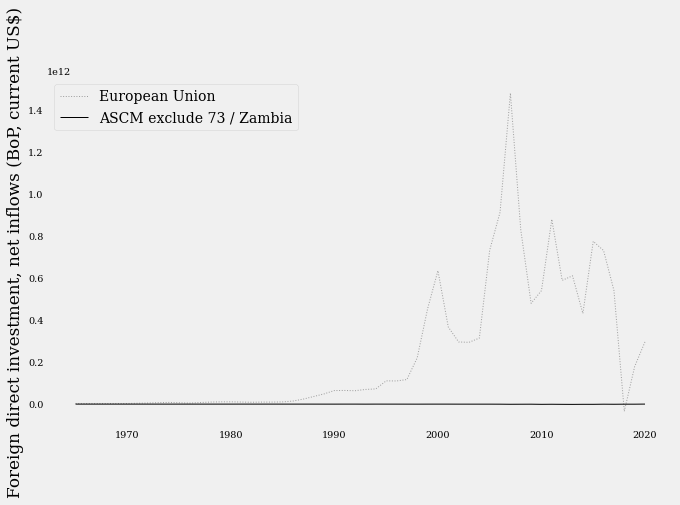

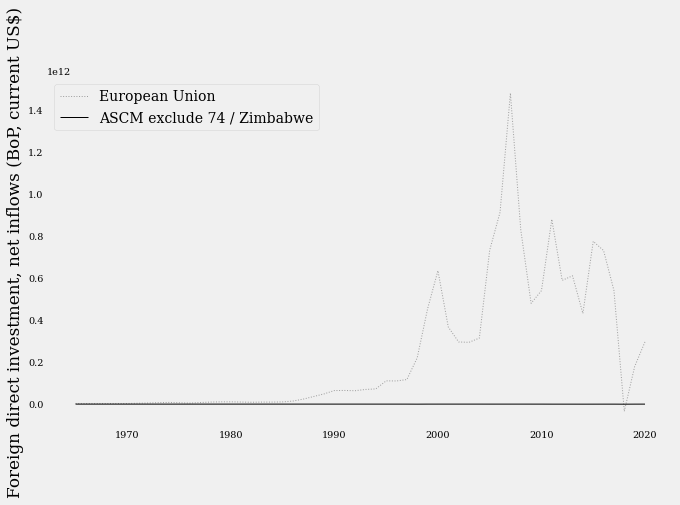

In [635]:
ascm_limit_donor_pool('European Union','Foreign direct investment, net inflows (BoP, current US$)', data_fdi, incident_year = 2009, std_scaling=True, detail = False, ylabel=False)